# H&M Personalized Fashion Recommendations

*NOTE* - Our file is runnable but there is too much data for our CPU's and take up a lot of RAM memory that's why not everything (our models) is fully loaded in our submission.

RECORDING: https://drive.google.com/drive/folders/1mvUnGLImi0OZ2YTejs7WSl64zmCvI63L

In [2]:
from IPython.core.debugger import set_trace
import sys, warnings, time, os, copy, gc, re, random, pickle
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd

from plotly.offline import plot, iplot, init_notebook_mode
import plotly.express as px 

import matplotlib.pyplot as plt
import seaborn as sns

import datetime as dt

import matplotlib.ticker as mtick

from skimage import io

from sklearn.decomposition import PCA

from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import *

plt.style.use('seaborn-white')
sns.set_style("whitegrid")
sns.despine()
plt.rc("figure", autolayout=True)
plt.rc("axes", labelweight="bold", labelsize="large", titleweight="bold", titlesize=14, titlepad=10)

<Figure size 432x288 with 0 Axes>

## Data

In [2]:
articles = pd.read_csv("articles.csv")
customers = pd.read_csv("customers.csv")
transactions = pd.read_csv("transactions_train.csv")

In [3]:
articles.info()
articles.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105542 entries, 0 to 105541
Data columns (total 25 columns):
 #   Column                        Non-Null Count   Dtype 
---  ------                        --------------   ----- 
 0   article_id                    105542 non-null  int64 
 1   product_code                  105542 non-null  int64 
 2   prod_name                     105542 non-null  object
 3   product_type_no               105542 non-null  int64 
 4   product_type_name             105542 non-null  object
 5   product_group_name            105542 non-null  object
 6   graphical_appearance_no       105542 non-null  int64 
 7   graphical_appearance_name     105542 non-null  object
 8   colour_group_code             105542 non-null  int64 
 9   colour_group_name             105542 non-null  object
 10  perceived_colour_value_id     105542 non-null  int64 
 11  perceived_colour_value_name   105542 non-null  object
 12  perceived_colour_master_id    105542 non-null  int64 
 13 

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,detail_desc
0,108775015,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,9,Black,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.
1,108775044,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,10,White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.
2,108775051,108775,Strap top (1),253,Vest top,Garment Upper body,1010017,Stripe,11,Off White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.
3,110065001,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,9,Black,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde..."
4,110065002,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,10,White,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde..."


In [4]:
customers.info()
customers.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1371980 entries, 0 to 1371979
Data columns (total 7 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   customer_id             1371980 non-null  object 
 1   FN                      476930 non-null   float64
 2   Active                  464404 non-null   float64
 3   club_member_status      1365918 non-null  object 
 4   fashion_news_frequency  1355971 non-null  object 
 5   age                     1356119 non-null  float64
 6   postal_code             1371980 non-null  object 
dtypes: float64(3), object(4)
memory usage: 73.3+ MB


,customer_id,FN,Active,club_member_status,fashion_news_frequency,age,postal_code
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,NaN,NaN,ACTIVE,NONE,49.0,52043ee2162cf5aa7ee79974281641c6f11a68d276429a...
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,NaN,NaN,ACTIVE,NONE,25.0,2973abc54daa8a5f8ccfe9362140c63247c5eee03f1d93...
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,NaN,NaN,ACTIVE,NONE,24.0,64f17e6a330a85798e4998f62d0930d14db8db1c054af6...
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,NaN,NaN,ACTIVE,NONE,54.0,5d36574f52495e81f019b680c843c443bd343d5ca5b1c2...
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,1.0,1.0,ACTIVE,Regularly,52.0,25fa5ddee9aac01b35208d01736e57942317d756b32ddd...


In [5]:
transactions.info()
transactions.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31788324 entries, 0 to 31788323
Data columns (total 5 columns):
 #   Column            Dtype  
---  ------            -----  
 0   t_dat             object 
 1   customer_id       object 
 2   article_id        int64  
 3   price             float64
 4   sales_channel_id  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.2+ GB


,t_dat,customer_id,article_id,price,sales_channel_id
0,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,663713001,0.050831,2
1,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,541518023,0.030492,2
2,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,505221004,0.015237,2
3,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687003,0.016932,2
4,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687004,0.016932,2


## Visualizations

In [6]:
# Clothing categories that contain the largest-smallest number of unique items

fig = px.pie(articles, values='article_id', 
             title='Distribution by Index Group Name',
             names='index_group_name',
             color_discrete_sequence=px.colors.sequential.RdBu,
             hover_data=['index_group_name'],
             labels={'index_group_name':'Index Group Name'},
            height=450)
fig.show()

In [7]:
#Garments sold per group name

fig = px.histogram(articles, x='garment_group_name',color="index_group_name", 
                   title="Index Group Name per Garment Group Name",
                  color_discrete_sequence=px.colors.sequential.Agsunset,
                  height=600)
fig.show()

In [8]:
df_cust_prices = transactions[["customer_id", "price"]].groupby("customer_id").sum()
df_cust_qty = transactions[["customer_id", "article_id"]].groupby("customer_id").count()
cust_qty_price = pd.merge(df_cust_prices, df_cust_qty, on='customer_id', how='inner')
cust_details = pd.merge(cust_qty_price, customers.drop("postal_code", axis=1), on='customer_id', how='inner')

cust_details['age_groups'] = pd.cut(cust_details['age'], bins=[16, 20, 30, 40,50, 60, 70, float('Inf')], labels=['16-20', '20-30','30-40','40-50','50-60','60-70' , '70+'])

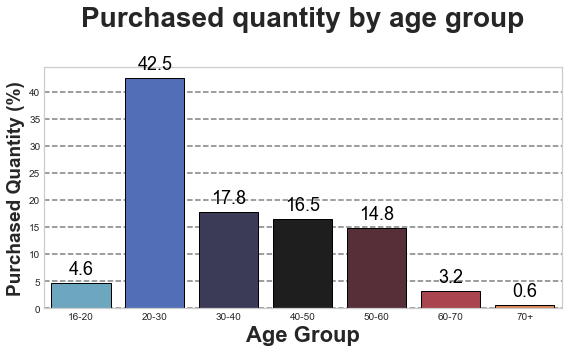

In [9]:
#Age groups that purchase the most-least amount of articles

plt.figure(figsize=(8,5))
plt.title("Purchased quantity by age group\n", fontweight="bold", size=28)
g = sns.barplot(x="age_groups", y="Purchased Quantity(%)", data=cust_details.groupby("age_groups")["article_id"].sum() \
            .transform(lambda x: (x / x.sum() * 100)).rename('Purchased Quantity(%)').reset_index(), palette="icefire", edgecolor="black")
plt.xlabel("Age Group",fontweight="bold", size=22)
plt.ylabel("Purchased Quantity (%)",fontweight="bold", size=19)
for container in g.containers:
    g.bar_label(container, padding = 5, fmt='%.1f', fontsize=18, color="black")
plt.grid(axis="y",color = 'grey', linestyle = '--', linewidth = 1.5)
plt.show()

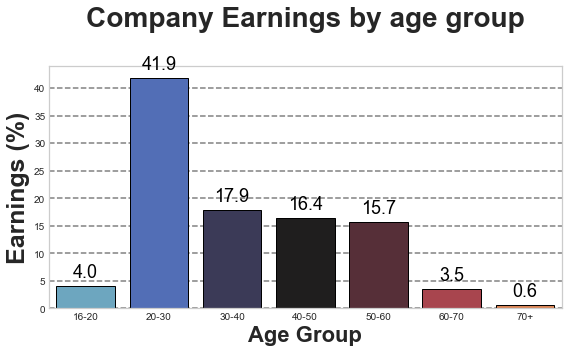

In [10]:
#Earning provided to the company from each customer age group

plt.figure(figsize=(8,5))
plt.title("Company Earnings by age group\n", fontweight="bold", size=28)
g = sns.barplot(x="age_groups", y="earning(%)", data=cust_details.groupby("age_groups")["price"].sum() \
            .transform(lambda x: (x / x.sum() * 100)).rename('earning(%)').reset_index(), palette="icefire",edgecolor="black")
plt.xlabel("Age Group",fontweight="bold", size=22)
plt.ylabel("Earnings (%)",fontweight="bold", size=25)
for container in g.containers:
    g.bar_label(container, padding = 5, fmt='%.1f', fontsize=18, color="black")
plt.grid(axis="y",color = 'grey', linestyle = '--', linewidth = 1.5)
plt.show()

In [11]:
merged_at = articles[['article_id', 'prod_name', 'product_type_name', 'product_group_name', 'index_name']]
merged_at = transactions.merge(merged_at, on='article_id', how='left')

In [12]:
# The amount of sales per index name

df7 = merged_at[['index_name', 'price']].groupby('index_name').sum()
fig = px.bar(df7,
             x=df7.price,
             y=df7.index,
             title='Sales per Index Name',
             text_auto='.2s',
             orientation='h',
             color_discrete_sequence=px.colors.diverging.Temps,         
             height=500,
            labels={'t_dat':'Transaction date', 'price':'Sales'})
fig.update_traces(textfont_size=11, textangle=0, textposition="outside", cliponaxis=False)
fig.update_layout(xaxis_title = 'Total Sale',yaxis_title ='Index Name')
fig.show()

In [13]:
# The date ranges provided. Change the datatype of transactions file
transactions['t_dat'] = pd.to_datetime(transactions['t_dat'])

In [14]:
begin = transactions['t_dat'].min()
end = transactions['t_dat'].max()
print('Date range is from {} to {}.'.format(begin.date(), end.date()))

Date range is from 2018-09-20 to 2020-09-22.


In [15]:
t_per_day = transactions.groupby('t_dat',as_index=False).count()

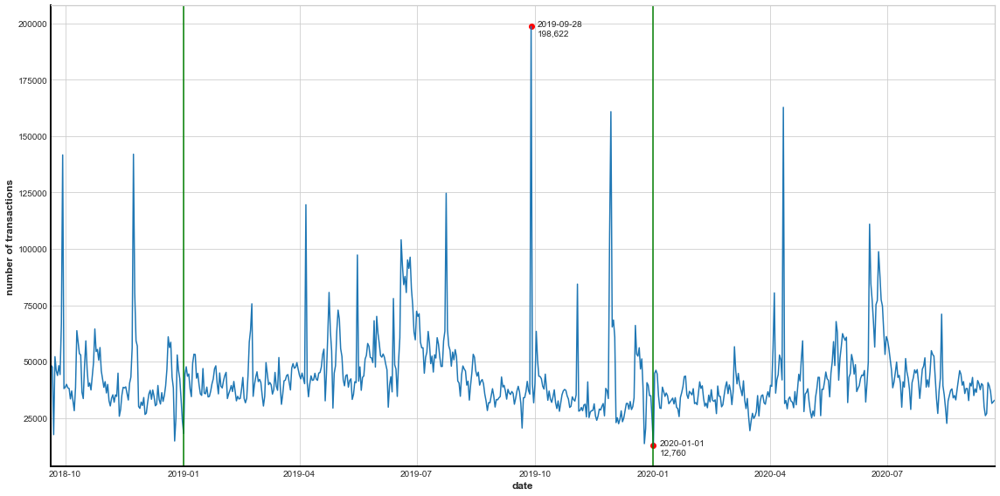

In [16]:
# Plot the number of transactions per day over the full period of time (2 years)

fig, ax = plt.subplots(figsize=(16,8))

sns.lineplot(data=t_per_day, x='t_dat',y='customer_id')

ax.set_xlabel('date')
ax.set_ylabel('number of transactions')

ax.axvline(x=dt.datetime(2019,1,1), c='green')
ax.axvline(x=dt.datetime(2020,1,1), c='green')

max_t = t_per_day['customer_id'].max()
max_t_date = t_per_day[t_per_day['customer_id']==max_t]['t_dat']
ax.scatter(max_t_date, max_t, c='red')
ax.text(max_t_date+pd.DateOffset(days=5), max_t-4000, '{}\n{:,d}'.format(max_t_date.iloc[0].date(), max_t))

min_t = t_per_day['customer_id'].min()
min_t_date = t_per_day[t_per_day['customer_id']==min_t]['t_dat']
ax.scatter(min_t_date, min_t, c='red')
ax.text(min_t_date+pd.DateOffset(days=5), min_t-4000, '{}\n{:,d}'.format(min_t_date.iloc[0].date(), min_t))
ax.set_xlim(transactions['t_dat'].min(),transactions['t_dat'].max())

for loc in ['bottom', 'left']:
    ax.spines[loc].set_visible(True)
    ax.spines[loc].set_linewidth(2)
    ax.spines[loc].set_color('black')

plt.show()

In [17]:
trans_gr_month = transactions.groupby('t_dat').size().rename("no_transactions")
trans_gr_month = trans_gr_month.reset_index()
trans_gr_month['month_year'] = trans_gr_month['t_dat'].dt.to_period('M')

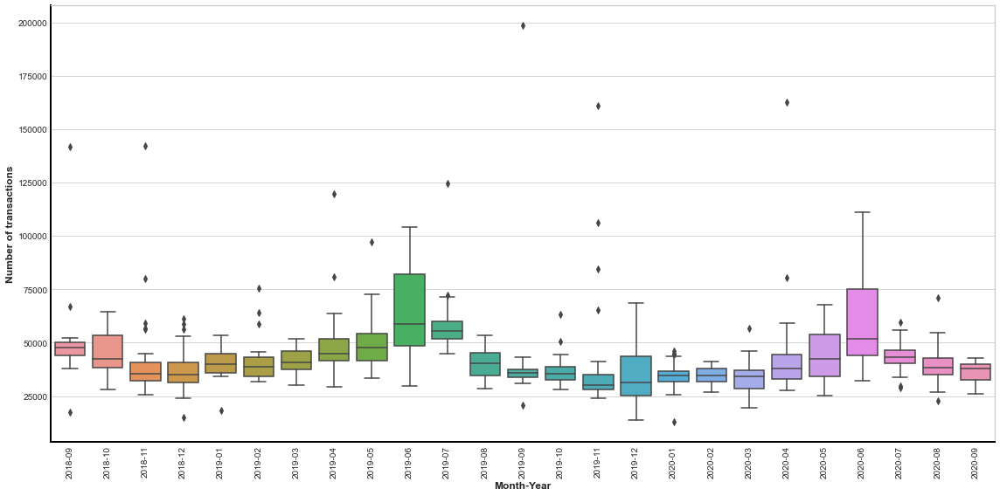

In [18]:
#A clearer visualization of distinct variations and spikes in the number of transactions per day

fig, ax = plt.subplots(figsize=(16,8))
ax = sns.boxplot(x="month_year", y='no_transactions', data=trans_gr_month)
plt.xticks(rotation=90)
for loc in ['bottom', 'left']:
    ax.spines[loc].set_visible(True)
    ax.spines[loc].set_linewidth(2)
    ax.spines[loc].set_color('black')
ax.set_xlabel('Month-Year')
ax.set_ylabel('Number of transactions')
plt.show()

In [19]:
articles_for_merge = articles[['article_id', 'prod_name', 'product_type_name', 'product_group_name', 'index_name']]
articles_for_merge = transactions[['customer_id', 'article_id', 'price', 't_dat']].merge(articles_for_merge, on='article_id', how='left')

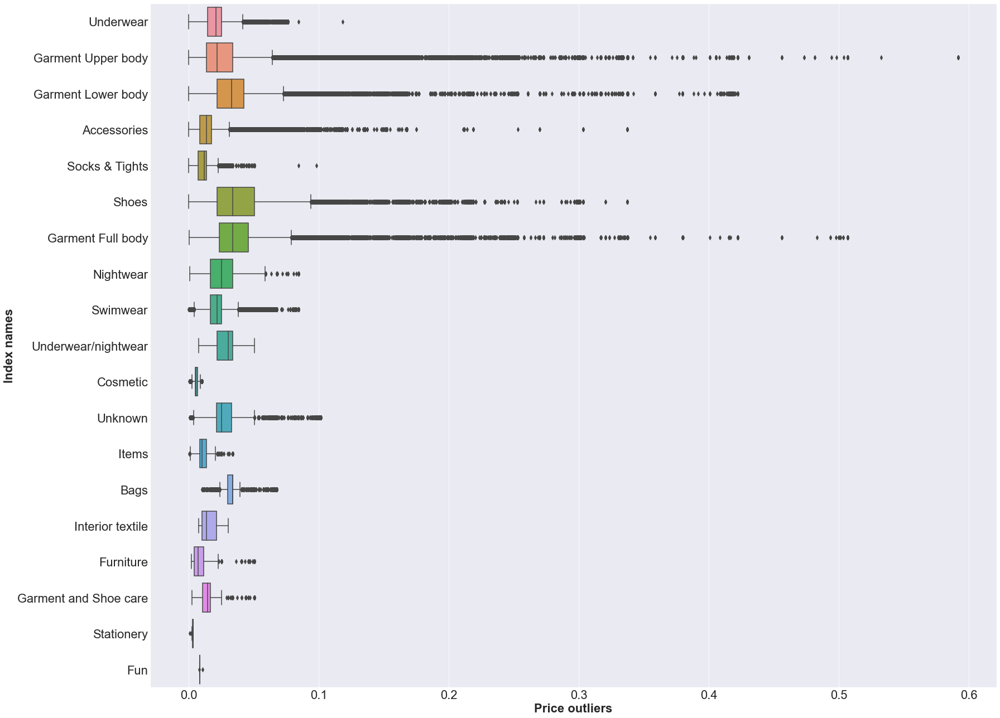

In [20]:
#Outliers for group name prices, each apparel categroy. 
#You'll see high price articles belong to the accessories group.

sns.set_style("darkgrid")
f, ax = plt.subplots(figsize=(25,18))
ax = sns.boxplot(data=articles_for_merge, x='price', y='product_group_name')
ax.set_xlabel('Price outliers', fontsize=22)
ax.set_ylabel('Index names', fontsize=22)
ax.xaxis.set_tick_params(labelsize=22)
ax.yaxis.set_tick_params(labelsize=22)

plt.show()

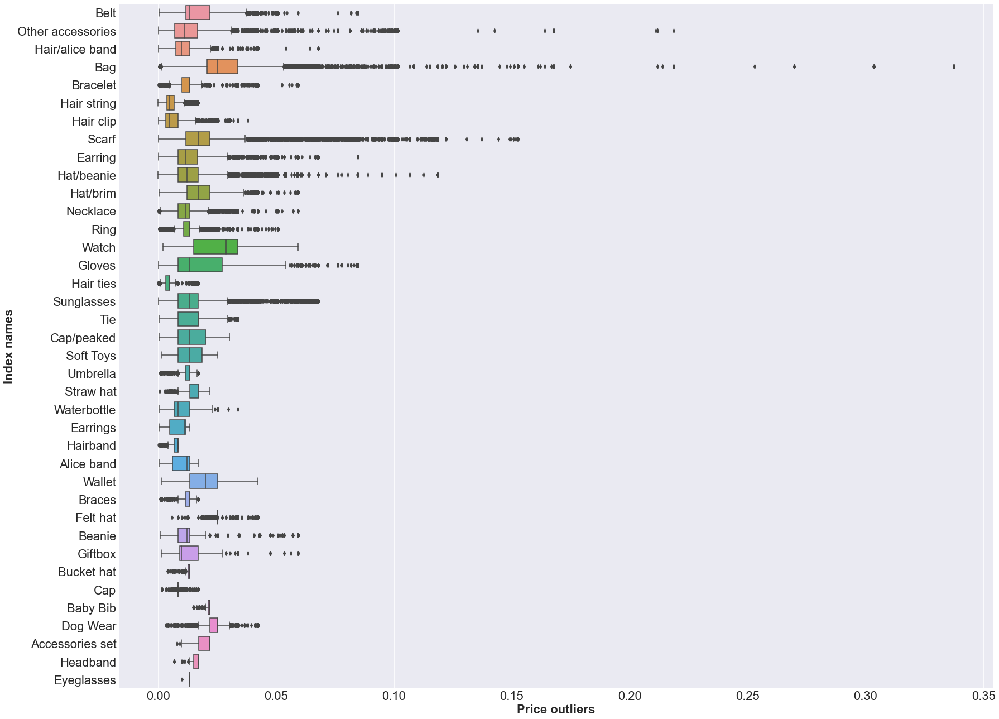

In [21]:
# Boxplot according to accessories product group and the high prices inside groups

sns.set_style("darkgrid")
f, ax = plt.subplots(figsize=(25,18))
_ = articles_for_merge[articles_for_merge['product_group_name'] == 'Accessories']
ax = sns.boxplot(data=_, x='price', y='product_type_name')
ax.set_xlabel('Price outliers', fontsize=22)
ax.set_ylabel('Index names', fontsize=22)
ax.xaxis.set_tick_params(labelsize=22)
ax.yaxis.set_tick_params(labelsize=22)
del _

plt.show()

## Data Cleaning

### Missing Values

In [22]:
#checking missing values in articles

articles.isnull ().sum ()

article_id                        0
product_code                      0
prod_name                         0
product_type_no                   0
product_type_name                 0
product_group_name                0
graphical_appearance_no           0
graphical_appearance_name         0
colour_group_code                 0
colour_group_name                 0
perceived_colour_value_id         0
perceived_colour_value_name       0
perceived_colour_master_id        0
perceived_colour_master_name      0
department_no                     0
department_name                   0
index_code                        0
index_name                        0
index_group_no                    0
index_group_name                  0
section_no                        0
section_name                      0
garment_group_no                  0
garment_group_name                0
detail_desc                     416
dtype: int64

In [23]:
#dropping articles missing values

articles = articles.dropna ()
articles.count()

article_id                      105126
product_code                    105126
prod_name                       105126
product_type_no                 105126
product_type_name               105126
product_group_name              105126
graphical_appearance_no         105126
graphical_appearance_name       105126
colour_group_code               105126
colour_group_name               105126
perceived_colour_value_id       105126
perceived_colour_value_name     105126
perceived_colour_master_id      105126
perceived_colour_master_name    105126
department_no                   105126
department_name                 105126
index_code                      105126
index_name                      105126
index_group_no                  105126
index_group_name                105126
section_no                      105126
section_name                    105126
garment_group_no                105126
garment_group_name              105126
detail_desc                     105126
dtype: int64

In [24]:
# after dropping the values in artciles
print (articles.isnull ().sum ())

article_id                      0
product_code                    0
prod_name                       0
product_type_no                 0
product_type_name               0
product_group_name              0
graphical_appearance_no         0
graphical_appearance_name       0
colour_group_code               0
colour_group_name               0
perceived_colour_value_id       0
perceived_colour_value_name     0
perceived_colour_master_id      0
perceived_colour_master_name    0
department_no                   0
department_name                 0
index_code                      0
index_name                      0
index_group_no                  0
index_group_name                0
section_no                      0
section_name                    0
garment_group_no                0
garment_group_name              0
detail_desc                     0
dtype: int64


In [25]:
# checking missing values in customers

customers.isnull ().sum ()

customer_id                    0
FN                        895050
Active                    907576
club_member_status          6062
fashion_news_frequency     16009
age                        15861
postal_code                    0
dtype: int64

In [26]:
#dropping the missing values in customers
customers = customers.dropna ()
customers.count()

customer_id               462911
FN                        462911
Active                    462911
club_member_status        462911
fashion_news_frequency    462911
age                       462911
postal_code               462911
dtype: int64

In [27]:
def create_age_interval(x):
    if x <= 25:
        return [16, 25]
    elif x <= 35:
        return [26, 35]
    elif x <= 45:
        return [36, 45]
    elif x <= 55:
        return [46, 55]
    elif x <= 65:
        return [56, 65]
    else:
        return [66, 99]

In [28]:
# set missing values in age with the median
customers["age"].fillna(customers["age"].median(), inplace=True)
customers["age_interval"] = customers ["age"].apply(lambda x:create_age_interval(x))

In [29]:
# after dropping the values in customers
print (customers.isnull().sum ())

customer_id               0
FN                        0
Active                    0
club_member_status        0
fashion_news_frequency    0
age                       0
postal_code               0
age_interval              0
dtype: int64


In [30]:
# checking missing values in transactions

transactions.isnull ().sum ()

t_dat               0
customer_id         0
article_id          0
price               0
sales_channel_id    0
dtype: int64

### Outliers

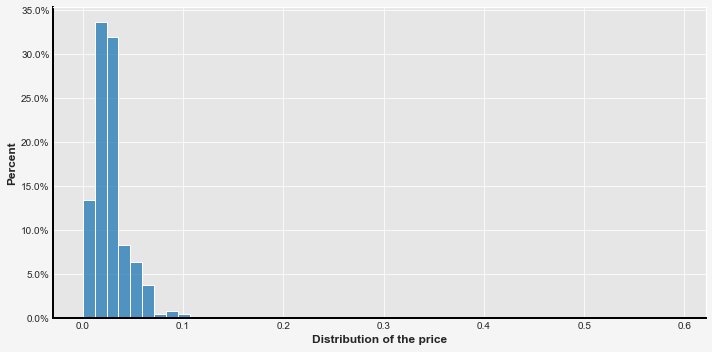

In [31]:
# Price column outliers from transactions
sns.set_style("darkgrid", {"axes.facecolor": ".9"})
fig, ax = plt.subplots(figsize=(10,5), facecolor='#f6f5f5')
ax = sns.histplot(data=transactions, x='price', bins=50, stat="percent")
ax.set_xlabel('Distribution of the price')
for loc in ['bottom', 'left']:
    ax.spines[loc].set_visible(True)
    ax.spines[loc].set_linewidth(2)
    ax.spines[loc].set_color('black')
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

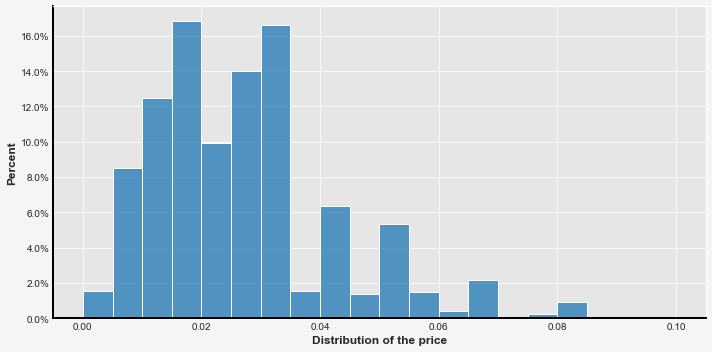

In [32]:
#Price column after cutting the values above 0.1

fig, ax = plt.subplots(figsize=(10,5), facecolor='#f6f5f5')
data = transactions[transactions['price']<0.1]
ax = sns.histplot(data=data, x='price', bins=20, stat="percent")
ax.set_xlabel('Distribution of the price')
for loc in ['bottom', 'left']:
    ax.spines[loc].set_visible(True)
    ax.spines[loc].set_linewidth(2)
    ax.spines[loc].set_color('black')
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

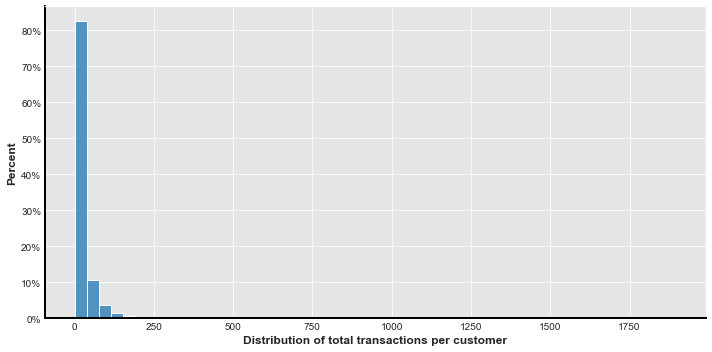

In [33]:
# Outliers for transactions, on average, that customers do

t_by_customer = transactions.groupby('customer_id', as_index=False).size()

fig, ax = plt.subplots(figsize=(10,5))
ax = sns.histplot(data=t_by_customer, x='size', bins=50, stat="percent")
ax.set_xlabel('Distribution of total transactions per customer')
for loc in ['bottom', 'left']:
    ax.spines[loc].set_visible(True)
    ax.spines[loc].set_linewidth(2)
    ax.spines[loc].set_color('black')
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

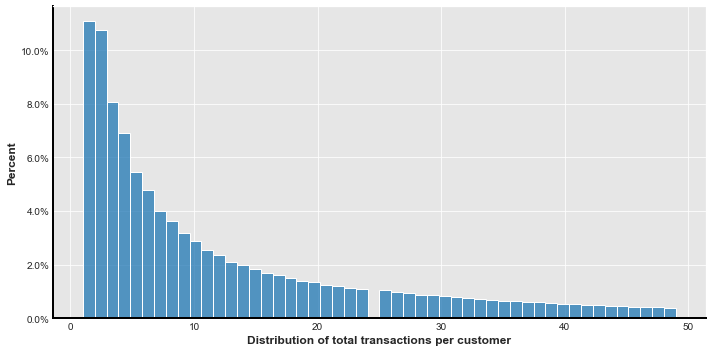

In [34]:
# cutting everything above 50 transactions per customer

t_by_customer_50tr = t_by_customer[t_by_customer['size'] < 50]

fig, ax = plt.subplots(figsize=(10,5))
ax = sns.histplot(data=t_by_customer_50tr, x='size', bins=50, stat="percent")
ax.set_xlabel('Distribution of total transactions per customer')
for loc in ['bottom', 'left']:
    ax.spines[loc].set_visible(True)
    ax.spines[loc].set_linewidth(2)
    ax.spines[loc].set_color('black')
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

### Inconsistencies

In [35]:
customers['fashion_news_frequency'].unique()

array(['Regularly', 'NONE', 'Monthly', 'None'], dtype=object)

In [36]:
#removing inconsistencies
customers.loc[~customers['fashion_news_frequency'].isin(['Regularly', 'Monthly']), 'fashion_news_frequency'] = 'None'
customers['fashion_news_frequency'].unique()

array(['Regularly', 'None', 'Monthly'], dtype=object)

### Creating New Features

In [37]:
dfCustomers = customers
dfCustomers = dfCustomers[['customer_id', 'age']]
dfCustomers = dfCustomers.astype({"age": int, "customer_id": str})

dfTransactions = transactions
dfTransactions = dfTransactions.astype({"article_id": int, "t_dat": str, "customer_id": str,
                                        "sales_channel_id":str})

In [38]:
# Add total number of purchasing.
dfTemp = dfTransactions.groupby(['customer_id']).count().reset_index()
dfCustomers = dfCustomers.merge(dfTemp[['customer_id', 'article_id']], on='customer_id', how='left')
dfCustomers = dfCustomers.rename(columns={'article_id': 'count_all'})
dfCustomers['count_all'] = dfCustomers['count_all'].fillna(0)
dfCustomers.head(3)

,customer_id,age,count_all
0,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,52,13.0
1,00007d2de826758b65a93dd24ce629ed66842531df6699...,32,120.0
2,00009d946eec3ea54add5ba56d5210ea898def4b46c685...,56,162.0


In [39]:
# Add how many % using sales channel 1.
dfTemp = dfTransactions.groupby(['customer_id', 'sales_channel_id']).count().reset_index()
dfTemp = dfTemp[dfTemp['sales_channel_id'] == '1']
dfCustomers = dfCustomers.merge(dfTemp[['customer_id', 'article_id']], on='customer_id', how='left')
dfCustomers = dfCustomers.rename(columns={'article_id': 'count_sales_ch1'})
dfCustomers['count_sales_ch1'] = dfCustomers['count_sales_ch1'].fillna(0)

dfCustomers['share_sales_ch1'] = dfCustomers['count_sales_ch1'] / dfCustomers['count_all']
dfCustomers['share_sales_ch1'] = dfCustomers['share_sales_ch1'].fillna(0)
dfCustomers.head(3)

,customer_id,age,count_all,count_sales_ch1,share_sales_ch1
0,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,52,13.0,2.0,0.153846
1,00007d2de826758b65a93dd24ce629ed66842531df6699...,32,120.0,3.0,0.025000
2,00009d946eec3ea54add5ba56d5210ea898def4b46c685...,56,162.0,1.0,0.006173


In [40]:
# Add total purchasing values & avg. purchasing price.

dfTemp = dfTransactions.groupby(['customer_id']).sum().reset_index()
dfCustomers = dfCustomers.merge(dfTemp[['customer_id', 'price']], on='customer_id', how='left')
dfCustomers = dfCustomers.rename(columns={'price': 'sum_price'})
dfCustomers['sum_price'] = dfCustomers['sum_price'].fillna(0)

dfTemp = dfTransactions.groupby(['customer_id']).mean().reset_index()
dfCustomers = dfCustomers.merge(dfTemp[['customer_id', 'price']], on='customer_id', how='left')
dfCustomers = dfCustomers.rename(columns={'price': 'mean_price'})
dfCustomers['mean_price'] = dfCustomers['mean_price'].fillna(0)
dfCustomers.head(3)

,customer_id,age,count_all,count_sales_ch1,share_sales_ch1,sum_price,mean_price
0,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,52,13.0,2.0,0.153846,0.469695,0.036130
1,00007d2de826758b65a93dd24ce629ed66842531df6699...,32,120.0,3.0,0.025000,3.823610,0.031863
2,00009d946eec3ea54add5ba56d5210ea898def4b46c685...,56,162.0,1.0,0.006173,5.007576,0.030911


In [41]:
#Add lag feature
transactions['t_dat'] = pd.to_datetime(transactions['t_dat'])

print(transactions.dtypes.t_dat)

datetime64[ns]


In [42]:
# computing purchase lag feature
start_of_observation = transactions["t_dat"].min()
transactions["offset_purchase_dat"] = transactions["t_dat"] - start_of_observation
transactions['prev_purchase_offset'] = transactions.groupby("customer_id")['offset_purchase_dat'].shift()

# deduplicate same day purchases per customer
df_removed_same_day_purchases =  transactions[transactions["offset_purchase_dat"] != transactions["prev_purchase_offset"]]
df_removed_same_day_purchases["purchase_lag"] = df_removed_same_day_purchases["offset_purchase_dat"] - df_removed_same_day_purchases["prev_purchase_offset"]

In [43]:
df_removed_same_day_purchases[df_removed_same_day_purchases["customer_id"] == 
                             "fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20e02ce5d1e58a8f700b"]

,t_dat,customer_id,article_id,price,sales_channel_id,offset_purchase_dat,prev_purchase_offset,purchase_lag
17629039,2019-10-06,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,811235004,0.030492,2,381 days,NaT,NaT
20407724,2019-12-20,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,829783006,0.044475,2,456 days,381 days,75 days
25237030,2020-04-29,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,837941001,0.049068,2,587 days,456 days,131 days
26679935,2020-06-01,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,698286007,0.025407,2,620 days,587 days,33 days
28071401,2020-06-25,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,698286007,0.025407,2,644 days,620 days,24 days
28223528,2020-06-27,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,868751001,0.025407,1,646 days,644 days,2 days
28516679,2020-07-02,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,718086004,0.050831,2,651 days,646 days,5 days
28915848,2020-07-11,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,902229003,0.050831,2,660 days,651 days,9 days
29361343,2020-07-22,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,829308003,0.033881,2,671 days,660 days,11 days
29406322,2020-07-23,fffef3b6b73545df065b521e19f64bf6fe93bfd450ab20...,678942057,0.016932,2,672 days,671 days,1 days


count                       7717898
mean     48 days 06:08:39.677456215
std      71 days 16:22:58.856560252
min                 1 days 00:00:00
10%                 2 days 00:00:00
20%                 5 days 00:00:00
30%                 9 days 00:00:00
40%                15 days 00:00:00
50%                22 days 00:00:00
60%                32 days 00:00:00
70%                47 days 00:00:00
80%                71 days 00:00:00
90%               124 days 00:00:00
100%              731 days 00:00:00
max               731 days 00:00:00
Name: purchase_lag, dtype: object

<AxesSubplot:xlabel='purchase_lag', ylabel='Density'>

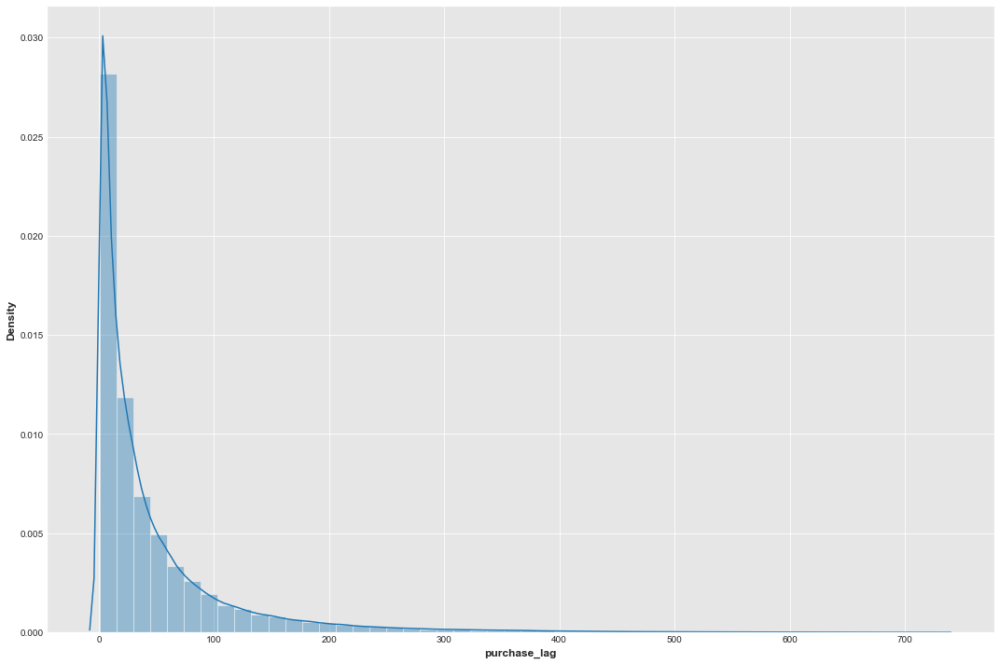

In [44]:
#unaveraged lag

display(df_removed_same_day_purchases["purchase_lag"].describe(percentiles = [0.1, 0.2, 0.3, 0.4, 0.5,
                                                                             0.6, 0.7, 0.8, 0.9, 1.0]))
plt.figure(figsize=(15,10))
sns.distplot(df_removed_same_day_purchases["purchase_lag"].dt.days)

<AxesSubplot:xlabel='purchase_lag', ylabel='Density'>

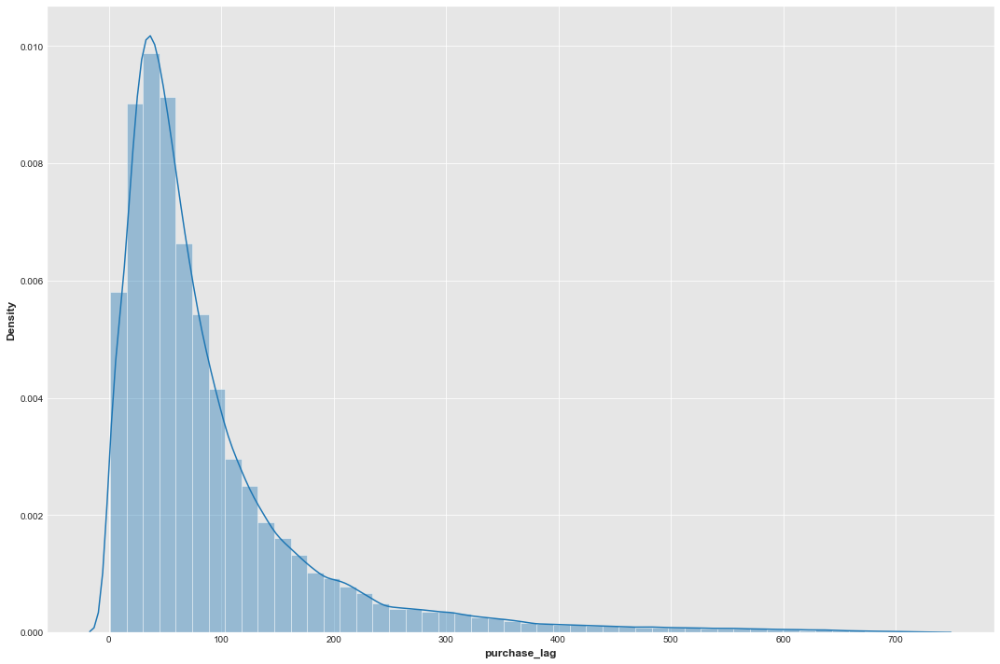

In [45]:
#average lag
average_purchase_lag_per_user = df_removed_same_day_purchases.groupby("customer_id")["purchase_lag"].mean()

average_purchase_lag_per_user.describe(percentiles = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0])

plt.figure(figsize=(15,10))
sns.distplot(average_purchase_lag_per_user.dt.days)

### Feature Analysis

In [46]:
a = transactions.merge(customers, on='customer_id', how='left')
a.corr()

,article_id,price,sales_channel_id,FN,Active,age
article_id,1.000000,0.141169,0.085231,NaN,NaN,-0.015050
price,0.141169,1.000000,0.165802,NaN,NaN,0.063051
sales_channel_id,0.085231,0.165802,1.000000,NaN,NaN,-0.024520
FN,NaN,NaN,NaN,NaN,NaN,NaN
Active,NaN,NaN,NaN,NaN,NaN,NaN
age,-0.015050,0.063051,-0.024520,NaN,NaN,1.000000


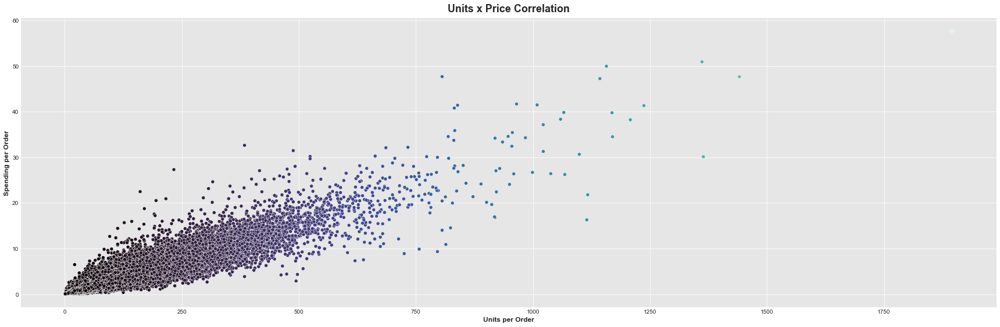

In [47]:
my_colors = ["#AF0848", "#E90B60", "#CB2170", "#954E93", "#705D98", "#5573A8", "#398BBB", "#00BDE3"]


# Data
basket = transactions.groupby("customer_id").agg({'article_id':'count', 'price': 'sum'}).reset_index()
basket.columns = ["customer_id", "units", "order_price"]


# correlation between purchase units and price
plt.figure(figsize=(24, 15))
ax3 = plt.subplot(2,1,2)
sns.scatterplot(data=basket, x="units", y="order_price", hue="units", palette="mako", legend=None, ax=ax3)
ax3.set_title("Units x Price Correlation", size=18, weight="bold")
ax3.set_ylabel("Spending per Order")
ax3.set_xlabel("Units per Order")
sns.despine(left=True, bottom=True)
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=None);

In [48]:
basket.corr()

,units,order_price
units,1.000000,0.958672
order_price,0.958672,1.000000


In [49]:
#Correlation between channele and purchase quantity
channelcor = a.groupby(['sales_channel_id']).agg({'article_id':'count'})
channelcor

,article_id
sales_channel_id,
1,9408462
2,22379862


In [50]:
#Correlation between member status and sale quantity
memberstatcor = a.groupby(['club_member_status']).agg({'article_id':'count'})
memberstatcor

,article_id
club_member_status,
ACTIVE,13303704
LEFT CLUB,9
PRE-CREATE,45444


In [51]:
#Correlation between fashion news frequency and purchase quantity
newscor = a.groupby(['fashion_news_frequency']).agg({'article_id':'count'})
newscor

,article_id
fashion_news_frequency,
Monthly,9753
None,7705
Regularly,13331699


### Data Reduction

In [3]:
df = pd.read_csv('transactions_train.csv', chunksize=100000, dtype=str)
articles = pd.read_csv('articles.csv', dtype=str)
users = next(df)
users = users.merge(articles, on='article_id')

In [4]:
users.head()

,t_dat,customer_id,article_id,price,sales_channel_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,detail_desc
0,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,0663713001,0.050830508474576264,2,0663713,Atlanta Push Body Harlow,283,Underwear body,Underwear,...,Expressive Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Lace push-up body with underwired, moulded, pa..."
1,2018-09-20,3681748607f3287d2c3a65e00bb5fb153de30e9becf158...,0663713001,0.04947457627118645,2,0663713,Atlanta Push Body Harlow,283,Underwear body,Underwear,...,Expressive Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Lace push-up body with underwired, moulded, pa..."
2,2018-09-20,4ef5967ff17bf474bffebe5b16bd54878e1d4105f7b4ed...,0663713001,0.050830508474576264,2,0663713,Atlanta Push Body Harlow,283,Underwear body,Underwear,...,Expressive Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Lace push-up body with underwired, moulded, pa..."
3,2018-09-20,6b7b10d2d47516c82a6f97332478dab748070f09693f09...,0663713001,0.050830508474576264,1,0663713,Atlanta Push Body Harlow,283,Underwear body,Underwear,...,Expressive Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Lace push-up body with underwired, moulded, pa..."
4,2018-09-20,8ac137752bbe914aa4ae6ad007a9a0c5b67a1ab2b2d474...,0663713001,0.050830508474576264,2,0663713,Atlanta Push Body Harlow,283,Underwear body,Underwear,...,Expressive Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Lace push-up body with underwired, moulded, pa..."


In [5]:
group_by_customer = users.groupby('customer_id')
groups = []
for key in group_by_customer.groups.keys():
    group = group_by_customer.get_group(key).sort_values(by='t_dat')
    for column in group.columns:
        group['next_{}'.format(column)] = group[column].shift(-1)
        
    group = group.drop_duplicates(subset=['customer_id', 'article_id']).iloc[:-1]
    groups.append(group)

In [6]:
grouped_by_customers = pd.concat(groups)

In [7]:
grouped_by_customers.head()

,t_dat,customer_id,article_id,price,sales_channel_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,...,next_department_name,next_index_code,next_index_name,next_index_group_no,next_index_group_name,next_section_no,next_section_name,next_garment_group_no,next_garment_group_name,next_detail_desc
7581,2018-09-21,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,0640244003,0.033881355932203386,2,0640244,CORY CORD SKIRT,275,Skirt,Garment Lower body,...,Dresses,D,Divided,2,Divided,53,Divided Collection,1013,Dresses Ladies,"Short, fitted dress in stretch denim with a co..."
20318,2018-09-21,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,0583558001,0.06777966101694916,2,0583558,Noel denim dress,265,Dress,Garment Full body,...,Blouse,A,Ladieswear,1,Ladieswear,15,Womens Everyday Collection,1010,Blouses,"Shirt in a cotton weave with a collar, buttons..."
0,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,0663713001,0.050830508474576264,2,0663713,Atlanta Push Body Harlow,283,Underwear body,Underwear,...,Casual Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Lace push-up bras with underwired, moulded, pa..."
26,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,0505221004,0.01523728813559322,2,0505221,Inca Jumper,252,Sweater,Garment Upper body,...,Campaigns,A,Ladieswear,1,Ladieswear,15,Womens Everyday Collection,1023,Special Offers,V-neck knitted jumper with long sleeves and ri...
37,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,0685687003,0.016932203389830508,2,0685687,W YODA KNIT OL OFFER,252,Sweater,Garment Upper body,...,Campaigns,A,Ladieswear,1,Ladieswear,15,Womens Everyday Collection,1023,Special Offers,V-neck knitted jumper with long sleeves and ri...


In [8]:
grouped_by_customers.nunique()[['customer_id', 'article_id', 'next_article_id']]

customer_id        18725
article_id         11635
next_article_id    14330
dtype: int64

In [9]:
df = grouped_by_customers[['t_dat', 'customer_id', 'article_id', 'prod_name', 'product_type_name',
       'product_group_name', 
       'graphical_appearance_name', 'colour_group_name',
       'perceived_colour_value_name',
       'perceived_colour_master_name',
       'department_name', 'index_name',
       'index_group_name', 'section_name',
       'garment_group_name', 'detail_desc', 'next_article_id']]

feature_subset = ['product_group_name', 
       'graphical_appearance_name', 'colour_group_name',
       'perceived_colour_value_name',
       'perceived_colour_master_name',
       'department_name', 'index_name',
       'index_group_name', 'section_name',
       'garment_group_name']

In [10]:
#Choose features to build feature space

features = feature_subset
df1 = df[['customer_id', 'article_id', 'next_article_id'] + features]
dummies_df = pd.get_dummies(df1, columns=features)
dummies_df

,customer_id,article_id,next_article_id,product_group_name_Accessories,product_group_name_Cosmetic,product_group_name_Garment Full body,product_group_name_Garment Lower body,product_group_name_Garment Upper body,product_group_name_Items,product_group_name_Nightwear,...,garment_group_name_Shorts,garment_group_name_Skirts,garment_group_name_Socks and Tights,garment_group_name_Special Offers,garment_group_name_Swimwear,garment_group_name_Trousers,garment_group_name_Trousers Denim,"garment_group_name_Under-, Nightwear",garment_group_name_Unknown,garment_group_name_Woven/Jersey/Knitted mix Baby
7581,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,0640244003,0583558001,0,0,0,1,0,0,0,...,0,1,0,0,0,0,0,0,0,0
20318,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,0583558001,0639677008,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,0663713001,0541518023,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
26,00007d2de826758b65a93dd24ce629ed66842531df6699...,0505221004,0685687003,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
37,00007d2de826758b65a93dd24ce629ed66842531df6699...,0685687003,0685687004,0,0,0,0,1,0,0,...,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17574,fff627c97a69e53afb4a2b49a3ebf7fa06660afaac959b...,0523488001,0630145002,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
42311,fff627c97a69e53afb4a2b49a3ebf7fa06660afaac959b...,0630145002,0673638005,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49272,fff627c97a69e53afb4a2b49a3ebf7fa06660afaac959b...,0673638005,0617279003,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
56093,fff627c97a69e53afb4a2b49a3ebf7fa06660afaac959b...,0617279003,0633870001,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,1,0


In [11]:
minimum_items = 2
groupby_customer = dummies_df.groupby('customer_id')

l = []
cutomer_ids = []
article_ids = []
next_article_ids = []
for key in groupby_customer.groups.keys():
    temp = groupby_customer.get_group(key)
    if temp.article_id.nunique() >= minimum_items:
        l.append(temp.drop('article_id', axis=1).sum(numeric_only=True).values)
        cutomer_ids.append(key)
        article_ids.extend(temp.article_id.values.tolist())
        next_article_ids.append(temp.next_article_id.values.tolist())

In [12]:
len(cutomer_ids), len(next_article_ids)

(12328, 12328)

In [13]:
next_article_ids[:5]

[['0583558001', '0639677008'],
 ['0685687003', '0685687004', '0685687001', '0505221001'],
 ['0501820008', '0543054005', '0640174004'],
 ['0501323011', '0598859003', '0688873020', '0688873011'],
 ['0377277001',
  '0377277001',
  '0553139001',
  '0680912009',
  '0664421002',
  '0640639001',
  '0692454002',
  '0680912006',
  '0685687002',
  '0676827002',
  '0631848002',
  '0631848002',
  '0671505001',
  '0501820043']]

In [14]:
user_feature = pd.DataFrame(l, columns = dummies_df.columns[3:])
normalized_user_feature = user_feature.div(user_feature.sum(axis=1), axis=0)
normalized_user_feature.insert(0, 'customer_id', cutomer_ids)
normalized_user_feature = normalized_user_feature.set_index('customer_id')
normalized_user_feature

,product_group_name_Accessories,product_group_name_Cosmetic,product_group_name_Garment Full body,product_group_name_Garment Lower body,product_group_name_Garment Upper body,product_group_name_Items,product_group_name_Nightwear,product_group_name_Shoes,product_group_name_Socks & Tights,product_group_name_Swimwear,...,garment_group_name_Shorts,garment_group_name_Skirts,garment_group_name_Socks and Tights,garment_group_name_Special Offers,garment_group_name_Swimwear,garment_group_name_Trousers,garment_group_name_Trousers Denim,"garment_group_name_Under-, Nightwear",garment_group_name_Unknown,garment_group_name_Woven/Jersey/Knitted mix Baby
customer_id,,,,,,,,,,,,,,,,,,,,,
0000423b00ade91418cceaf3b26c6af3dd342b51fd051eec9c12fb36984420fa,0.000000,0.0,0.05,0.050000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.050000,0.0,0.000000,0.0,0.000,0.0,0.000000,0.00,0.0
00007d2de826758b65a93dd24ce629ed66842531df6699338c5570910a014cc2,0.000000,0.0,0.00,0.000000,0.100000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.075000,0.0,0.000,0.0,0.000000,0.00,0.0
0003abe64294e66a6310c3436fa9e5b754cc5603deef4f26fc8ab8d043af9358,0.000000,0.0,0.00,0.000000,0.100000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.000000,0.0,0.000,0.0,0.033333,0.00,0.0
00083cda041544b2fbb0e0d2905ad17da7cf1007526fb4c73235dccbbc132280,0.000000,0.0,0.00,0.050000,0.050000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.000000,0.0,0.050,0.0,0.000000,0.00,0.0
000aa7f0dc06cd7174389e76c9e132a67860c5f65f970699daccc14425ac31a8,0.007143,0.0,0.00,0.007143,0.085714,0.0,0.0,0.0,0.0,0.0,...,0.0,0.007143,0.0,0.021429,0.0,0.000,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fff04954c6e484a8deb5ec475e581aefd25d5850d1886f6c0198edaa9b67c958,0.000000,0.0,0.00,0.000000,0.100000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.000000,0.0,0.000,0.0,0.000000,0.00,0.0
fff15526121f7d914a54784e68761a1d30b7547e3555738dcceb386eaaa24c4b,0.000000,0.0,0.00,0.025000,0.075000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.000000,0.0,0.025,0.0,0.000000,0.00,0.0
fff3e75605ec575be9b95eda1e6557299e81bba12668d750c0e973528e48b7ee,0.000000,0.0,0.00,0.025000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.025000,0.0,0.000,0.0,0.075000,0.00,0.0


In [15]:
item_feature = dummies_df.drop_duplicates(subset='article_id')
item_feature = item_feature[item_feature.article_id.isin(article_ids)].drop(['customer_id', 'next_article_id'], axis=1)
item_feature = item_feature.set_index('article_id')
item_feature

,product_group_name_Accessories,product_group_name_Cosmetic,product_group_name_Garment Full body,product_group_name_Garment Lower body,product_group_name_Garment Upper body,product_group_name_Items,product_group_name_Nightwear,product_group_name_Shoes,product_group_name_Socks & Tights,product_group_name_Swimwear,...,garment_group_name_Shorts,garment_group_name_Skirts,garment_group_name_Socks and Tights,garment_group_name_Special Offers,garment_group_name_Swimwear,garment_group_name_Trousers,garment_group_name_Trousers Denim,"garment_group_name_Under-, Nightwear",garment_group_name_Unknown,garment_group_name_Woven/Jersey/Knitted mix Baby
article_id,,,,,,,,,,,,,,,,,,,,,
0640244003,0,0,0,1,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
0583558001,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0663713001,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
0505221004,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0685687003,0,0,0,0,1,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0651490002,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0656609001,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
0618319001,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [16]:
scores = normalized_user_feature.dot(item_feature.T)
scores

article_id,0640244003,0583558001,0663713001,0505221004,0685687003,0685687004,0685687001,0591334019,0501820008,0543054005,...,0624445013,0569976008,0581138002,0715881001,0630037024,0651490002,0656609001,0618319001,0619562001,0652731001
customer_id,,,,,,,,,,,,,,,,,,,,,
0000423b00ade91418cceaf3b26c6af3dd342b51fd051eec9c12fb36984420fa,0.650000,0.650000,0.200000,0.250000,0.000000,0.050000,0.050000,0.150000,0.400000,0.400000,...,0.050,0.200000,0.050000,0.150000,0.050000,0.150000,0.050000,0.200000,0.250000,0.250000
00007d2de826758b65a93dd24ce629ed66842531df6699338c5570910a014cc2,0.100000,0.075000,0.125000,0.450000,0.700000,0.675000,0.675000,0.300000,0.275000,0.225000,...,0.000,0.150000,0.375000,0.050000,0.125000,0.150000,0.100000,0.150000,0.125000,0.200000
0003abe64294e66a6310c3436fa9e5b754cc5603deef4f26fc8ab8d043af9358,0.366667,0.266667,0.233333,0.300000,0.166667,0.333333,0.266667,0.566667,0.666667,0.700000,...,0.000,0.266667,0.366667,0.233333,0.100000,0.200000,0.166667,0.266667,0.133333,0.166667
00083cda041544b2fbb0e0d2905ad17da7cf1007526fb4c73235dccbbc132280,0.225000,0.025000,0.275000,0.075000,0.250000,0.300000,0.300000,0.375000,0.175000,0.100000,...,0.025,0.225000,0.250000,0.100000,0.075000,0.150000,0.125000,0.225000,0.050000,0.475000
000aa7f0dc06cd7174389e76c9e132a67860c5f65f970699daccc14425ac31a8,0.364286,0.164286,0.214286,0.235714,0.221429,0.264286,0.278571,0.242857,0.357143,0.307143,...,0.100,0.278571,0.171429,0.100000,0.142857,0.271429,0.242857,0.264286,0.171429,0.207143
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fff04954c6e484a8deb5ec475e581aefd25d5850d1886f6c0198edaa9b67c958,0.375000,0.125000,0.300000,0.200000,0.225000,0.300000,0.300000,0.300000,0.325000,0.300000,...,0.100,0.375000,0.200000,0.150000,0.150000,0.375000,0.125000,0.350000,0.150000,0.350000
fff15526121f7d914a54784e68761a1d30b7547e3555738dcceb386eaaa24c4b,0.300000,0.200000,0.125000,0.325000,0.150000,0.200000,0.250000,0.225000,0.375000,0.325000,...,0.075,0.175000,0.175000,0.125000,0.250000,0.175000,0.200000,0.175000,0.150000,0.125000
fff3e75605ec575be9b95eda1e6557299e81bba12668d750c0e973528e48b7ee,0.250000,0.000000,0.700000,0.000000,0.200000,0.300000,0.300000,0.375000,0.175000,0.100000,...,0.000,0.225000,0.125000,0.125000,0.000000,0.150000,0.075000,0.225000,0.025000,0.300000


In [17]:
# normalized_user_feature.to_csv('normalized_user_feature.csv')
# item_feature.to_csv('item_feature.csv')
# scores.to_csv('scores.csv')

In [18]:
pca = PCA(n_components=100)
pca.fit(normalized_user_feature)
pca.explained_variance_ratio_.sum()

0.9631993367416423

In [19]:
user_feature_pca = pd.DataFrame(pca.transform(normalized_user_feature), columns=['component_{}'.format(i) for i in range(1, 101)]).set_index(normalized_user_feature.index)
item_feature_pca = pd.DataFrame(pca.transform(item_feature), columns=['component_{}'.format(i) for i in range(1, 101)]).set_index(item_feature.index)

In [ ]:
scores_pca = user_feature_pca.dot(item_feature_pca.T)

In [23]:
user_feature_pca

,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10,...,component_91,component_92,component_93,component_94,component_95,component_96,component_97,component_98,component_99,component_100
customer_id,,,,,,,,,,,,,,,,,,,,,
0000423b00ade91418cceaf3b26c6af3dd342b51fd051eec9c12fb36984420fa,0.143083,0.004212,-0.057250,0.055040,-0.055703,-0.010363,0.004796,-0.021367,0.015307,-0.022923,...,-0.011890,0.016034,0.011846,0.003951,-0.004180,-0.003132,0.006288,-0.001107,-0.002384,0.004005
00007d2de826758b65a93dd24ce629ed66842531df6699338c5570910a014cc2,-0.066765,-0.091200,-0.011201,-0.030123,-0.008897,-0.095704,0.002397,-0.029640,-0.009256,0.027944,...,-0.000233,-0.004478,-0.000199,-0.003826,0.000861,0.002943,-0.001643,-0.011654,0.002150,0.001371
0003abe64294e66a6310c3436fa9e5b754cc5603deef4f26fc8ab8d043af9358,0.056458,-0.043277,-0.041303,-0.039136,-0.039714,-0.032078,-0.027405,0.064305,0.030868,-0.060998,...,-0.009006,0.006070,-0.005213,-0.011779,-0.005271,0.009332,0.000673,-0.000013,0.001497,0.001871
00083cda041544b2fbb0e0d2905ad17da7cf1007526fb4c73235dccbbc132280,-0.078618,-0.000246,-0.012581,0.041099,-0.003962,0.054610,0.006035,0.026646,0.015256,-0.028470,...,0.003533,0.001746,-0.001291,0.000673,-0.000830,0.000977,0.000887,-0.001375,0.000296,0.000764
000aa7f0dc06cd7174389e76c9e132a67860c5f65f970699daccc14425ac31a8,0.048539,-0.026778,-0.040163,-0.049968,-0.022973,0.016338,0.031587,-0.021276,-0.015052,0.007348,...,-0.002324,0.002138,0.002561,0.003079,0.000952,0.001803,-0.000818,-0.000913,0.000111,0.002463
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fff04954c6e484a8deb5ec475e581aefd25d5850d1886f6c0198edaa9b67c958,0.019474,0.012568,-0.064121,-0.055123,0.010517,-0.015883,0.023027,-0.019208,-0.043847,-0.019117,...,0.004622,-0.006472,0.001570,0.000487,0.000651,0.000676,-0.003478,-0.006166,0.004639,-0.000242
fff15526121f7d914a54784e68761a1d30b7547e3555738dcceb386eaaa24c4b,0.059194,-0.059202,-0.028715,-0.016419,-0.028291,0.001465,0.029398,0.004888,0.013177,0.003366,...,-0.007364,0.009815,0.001761,0.002079,0.010850,-0.005260,0.008402,0.015506,-0.007123,-0.002089
fff3e75605ec575be9b95eda1e6557299e81bba12668d750c0e973528e48b7ee,-0.032339,0.105377,0.101038,0.000170,-0.072410,-0.051660,0.008483,0.044056,-0.018472,-0.018788,...,-0.001545,0.001466,-0.000021,-0.002508,0.001548,-0.000968,-0.000967,-0.001549,-0.001307,-0.000527


In [24]:
item_feature_pca

,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10,...,component_91,component_92,component_93,component_94,component_95,component_96,component_97,component_98,component_99,component_100
article_id,,,,,,,,,,,,,,,,,,,,,
0640244003,0.913267,1.229648,-1.725162,0.291411,-0.448509,0.009229,0.056369,-0.012256,0.130056,-0.263899,...,-0.228274,0.438772,0.424880,0.006116,-0.098108,0.113844,0.108516,-0.110984,-0.075293,0.070557
0583558001,1.047923,-0.559164,-0.643355,0.683745,-0.868748,-0.181002,0.032714,0.005017,-0.004972,-0.571008,...,-0.094229,-0.192485,-0.143466,0.085822,0.060412,-0.235015,0.140494,-0.019740,0.053773,0.093175
0663713001,-0.555871,2.302584,0.340474,-0.339977,-0.825086,-0.451751,-0.016266,0.559414,-0.392415,-0.427054,...,-0.044543,-0.015252,0.052742,-0.023452,0.031321,-0.006001,0.068212,-0.052644,0.001952,0.026310
0505221004,0.413399,-0.896809,-0.773824,-0.572242,-0.673641,-0.798679,-0.173822,0.148398,0.289015,0.093237,...,-0.008243,-0.174537,-0.011575,-0.098328,0.046050,0.117780,-0.006783,-0.506662,0.126361,0.104678
0685687003,-1.576928,-0.774887,-0.493028,-0.332306,-0.235774,-0.776399,0.182049,-0.206105,-0.251194,0.197142,...,-0.082856,-0.064639,0.043204,-0.048113,0.048384,-0.053155,0.063205,-0.076498,-0.035222,0.026089
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0651490002,0.224331,0.719508,-0.621455,-0.724591,1.376267,-0.295203,0.024387,-0.220664,-0.521641,-0.955354,...,0.071502,-0.043599,0.130607,-0.113987,-0.018178,-0.130469,0.372608,-0.046740,0.010411,0.202056
0656609001,-0.054074,-0.323103,-0.034948,-0.758451,0.009579,1.277068,-0.059583,0.679241,-0.172324,0.534481,...,-0.180885,-0.000310,-0.073133,0.065614,0.013758,-0.141155,0.241261,-0.137071,0.100286,-0.073618
0618319001,-0.032474,1.092379,-0.971954,-0.755284,0.626625,0.106584,-0.602438,0.740421,-0.089559,0.233096,...,0.044525,-0.002967,0.068713,0.018406,0.118214,-0.035083,-0.019707,-0.037357,0.012047,-0.131671


In [ ]:
scores_pca

## Model Training

In [ ]:
# # Sampling 10000
# df = pd.read_csv('../input/h-and-m-personalized-fashion-recommendations/transactions_train.csv', chunksize=10000, dtype=str)
# articles = pd.read_csv('../input/h-and-m-personalized-fashion-recommendations/articles.csv', dtype=str)
# users = next(df)
# users = users.merge(articles, on='article_id')

# Sample 10%
df = pd.read_csv('transactions_train.csv', dtype=str).sample(3200000)
articles = pd.read_csv('articles.csv', dtype=str).sample(11000)
users = df.merge(articles, on='article_id')

In [ ]:
users.shape

In [ ]:
features = dummies_df.drop(['customer_id', 'article_id', 'next_article_id'], axis=1)
normed_features = features.div(features.sum(axis=1), axis=0)
normed_features.head()

In [ ]:
pca = PCA(n_components=100)
pca.fit(normed_features)
pca.explained_variance_ratio_.sum()

In [ ]:
features_pca = pca.transform(normed_features)

In [ ]:
target = dummies_df.next_article_id
le = LabelEncoder()
target = le.fit_transform(target)
target

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(features_pca, target, test_size=0.2, random_state=42)

**1. Naive Bayes**

In [ ]:
clf = GaussianNB()
clf.fit(x_train, y_train)

In [ ]:
clf.score(x_train, y_train), clf.score(x_test, y_test)

**2. Decision Tree**

In [ ]:
tree = DecisionTreeClassifier()
tree.fit(x_train, y_train)

In [ ]:
tree.score(x_train, y_train), tree.score(x_test, y_test)

**3. Logistic Regression**

In [ ]:
clf = LogisticRegression(C=5.0, penalty="l1", tol=0.01, solver="saga")
clf.fit(x_train, y_train)

In [ ]:
clf.score(x_train, y_train), clf.score(x_test, y_test)